In [1]:
# Install flory
!pip install flory

import numpy as np
DTYPE = np.float64
import flory
import matplotlib.pyplot as plt
%matplotlib notebook
%matplotlib widget
import os
import sys
import pandas as pd
from tqdm import tqdm
import plotly.graph_objects as go


In [2]:
def floryHuggins(phi:DTYPE, chi:np.array):
    part_1 = np.sum(phi*np.log(phi))
    part_2 = 0

    for i in range(len(phi)):
        for j in range(i+1, len(phi)):
            part_2 += chi[i][j]*phi[i]*phi[j]

    return part_1 + part_2

In [3]:
# Interaction matrix
chis = np.array([[0, 3.0, 3.0], [3.0, 0.0, 3.0], [3.0, 3.0, 0.0]], dtype = DTYPE)

# Global value of phis
phi_global = np.array([0.3, 0.4, 0.3], dtype = DTYPE)

# Equilibrium 3 phase solution
phases = flory.find_coexisting_phases(3, chis, phi_global, progress=False)

print("\n" + f"Equlibrium phase volumes: {phases.volumes}")
print("Equlibrium phase concentrations:\n" + f"{phases.fractions}")

# Take the transpose as the notation is different:
# For me: phi_ij = component i in compartment j
# For flory: phi_ji = component i in compartment j (OR I THINK SO!)

phases.fractions = np.transpose(phases.fractions)


Equlibrium phase volumes: [0.28679988 0.28680978 0.42639034]
Equlibrium phase concentrations:
[[0.8109213  0.09453818 0.09454047]
 [0.09454611 0.81090789 0.09454612]
 [0.09454042 0.09453814 0.81092139]]


In [4]:
# Free energy of the 3 phase system

F_flory = 0
for i in range(len(phases.volumes)):
    F_flory += phases.volumes[i]*floryHuggins(phases.fractions[:, i], chis)

print(F_flory)


-0.12914677532027796


In [5]:
# Merging compartments 1 and 3

eta_mod = phases.volumes[0] + phases.volumes[2]
phi_1mod = (phases.volumes[0]*phases.fractions[0, 0] + phases.volumes[2]*phases.fractions[0, 2])/eta_mod
phi_2mod = (phases.volumes[0]*phases.fractions[1, 0] + phases.volumes[2]*phases.fractions[1, 2])/eta_mod
phi_3mod = 1 - phi_1mod - phi_2mod


phi_in_kmod = [phi_1mod, phi_2mod, phi_3mod]
phi_in_k2 = [phases.fractions[0, 1], phases.fractions[1, 1], phases.fractions[2, 1]]

# Calculate the Free Energy of this modified system
# i.e. Free Energy of the proposal

F_mod = eta_mod*floryHuggins(phi_in_kmod, chis) + phases.volumes[1]*floryHuggins(phi_in_k2, chis)
print(F_mod)

-0.08887437179731722


In [6]:
phi_1mod, phi_2mod

(0.38262337825528986, 0.09453815507797676)

In [7]:
# Effectively 2 degrees of freedom in the system
step_size = DTYPE(0.001)
n_points = 1000

phi_1mod_perturbed = np.linspace(phi_1mod-n_points*step_size, phi_1mod+n_points*step_size, 2*n_points+1)
phi_2mod_perturbed = np.linspace(phi_2mod-n_points*step_size, phi_2mod+n_points*step_size, 2*n_points+1)

accepted_phi_1mod_perturbed = []
accepted_phi_2mod_perturbed = []
accepted_Fs_mod = []

In [8]:
phi_1mod, phi_2mod

(0.38262337825528986, 0.09453815507797676)

In [9]:
np.min(phi_1mod_perturbed), np.max(phi_1mod_perturbed)

(-0.11737662174471014, 0.8826233782552899)

In [10]:
ctr = 0

for phi_1m in phi_1mod_perturbed:
    for phi_2m in phi_2mod_perturbed:
        if phi_1m<0 or phi_2m<0 or phi_1m>1 or phi_2m>1:
            continue
        
        phi_3m = 1 - phi_1m - phi_2m
        if phi_3m<0 or phi_3m>1:
            continue
            
        phi_12mod = (phi_global[0] - phi_1m*(eta_mod))/(phases.volumes[1])
        phi_22mod = (phi_global[1] - phi_2m*(eta_mod))/(phases.volumes[1])
       
        if phi_12mod<0 or phi_12mod>1 or phi_22mod<0 or phi_22mod>1:
            continue
        
        phi_32mod = 1 - phi_12mod - phi_22mod
        if phi_32mod<0 or phi_32mod>1:
            continue

        ctr += 1

        phi_in_kmod = [phi_1m, phi_2m, phi_3m]
        phi_in_k2 = [phi_12mod, phi_22mod, phi_32mod]
        
        F = 0
        F = eta_mod*floryHuggins(phi_in_kmod, chis) + phases.volumes[1]*floryHuggins(phi_in_k2, chis)

        accepted_phi_1mod_perturbed.append(phi_1m)
        accepted_phi_2mod_perturbed.append(phi_2m)
        accepted_Fs_mod.append(F)

In [11]:
ctr/len(phi_1mod_perturbed)**2

0.08124343189278255

In [12]:
df = pd.DataFrame()
df["phi_1mod"] = accepted_phi_1mod_perturbed
df["phi_2mod"] = accepted_phi_2mod_perturbed
df["F"] = accepted_Fs_mod

df

,phi_1mod,phi_2mod,F
0,0.018623,0.420538,-0.000893
1,0.019623,0.419538,-0.004844
2,0.019623,0.420538,-0.004925
3,0.020623,0.418538,-0.007981
4,0.020623,0.419538,-0.008845
...,...,...,...
81401,0.420623,0.416538,-0.071974
81402,0.420623,0.417538,-0.070589
81403,0.420623,0.418538,-0.068978
81404,0.420623,0.419538,-0.067021


In [13]:
min_F_row = df[df['F'] == df['F'].min()]
min_F_row

,phi_1mod,phi_2mod,F
65298,0.378623,0.378538,-0.106526


In [14]:
min_F_row["phi_1mod"].values[0], min_F_row["phi_2mod"].values[0]

(0.37862337825528986, 0.3785381550779768)

In [15]:
phi_1mod, phi_2mod

(0.38262337825528986, 0.09453815507797676)

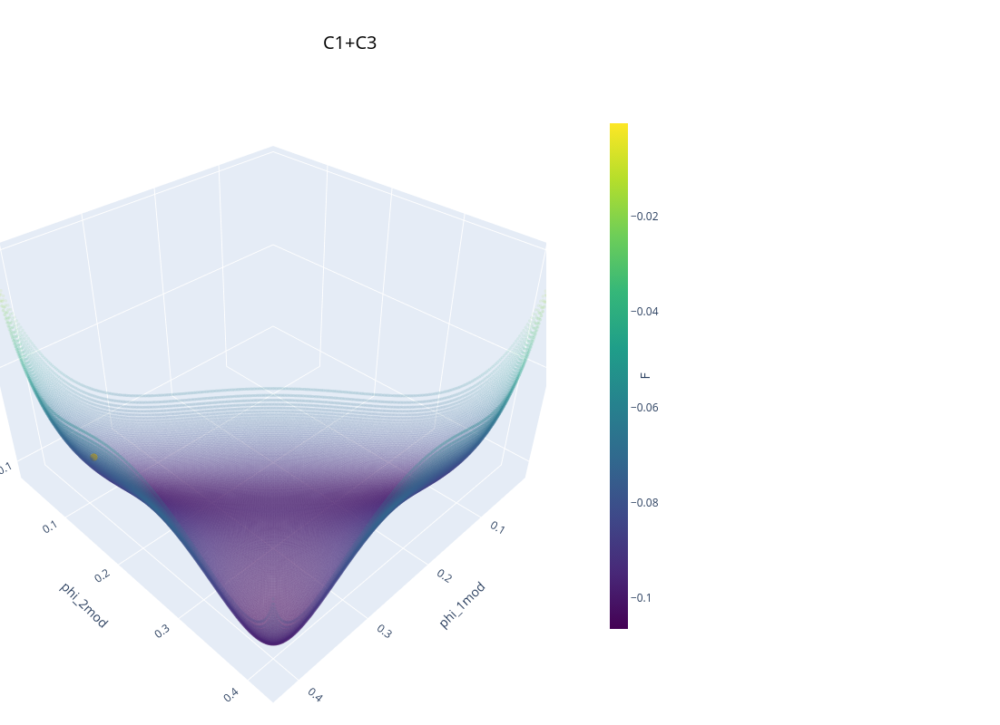

In [16]:
fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=pd.Series(df["phi_1mod"].values.ravel()),
    y=pd.Series(df["phi_2mod"].values.ravel()),
    z=pd.Series(df["F"].values.ravel()),
    mode='markers',
    marker=dict(
        size=2,
        color=pd.Series(df["F"].values.ravel()),  # Color by F values
        colorscale='Viridis',
        opacity = 0.1,
        colorbar=dict(
            title='F',  # Colorbar title
            titleside='right',
            titlefont=dict(size=14),
            thickness=20,
            len=0.75,
            x=1.1  # Position adjustment
        ),
        cmin=df["F"].min(),  # Set color scale range
        cmax=df["F"].max()
    ),
    showlegend=False  # Add this to each trace

))

fig.add_trace(go.Scatter3d(
    x=pd.Series(phi_1mod.ravel()),
    y=pd.Series(phi_2mod.ravel()),
    z=pd.Series(F_mod.ravel()),
    mode='markers',
    marker=dict(
        size=5,
        color='orange',
        symbol='circle'
    ),
    showlegend=False  # Add this to each trace
))

fig.update_layout(
    title={
    'text': "C1+C3",  # Title text
    'y':0.95,  # Position from top (0-1)
    'x':0.35,   # Center the title
    'xanchor': 'center',
    'yanchor': 'top',
    'font': dict(
        size=20,  # Title font size
        color='black'  # Title color
    )
    },

    width=1200,  # Width in pixels
    height=800,   # Height in pixels
    autosize=False,  # Disable autosizing
    scene=dict(
        xaxis_title='phi_1mod',
        yaxis_title='phi_2mod',
        zaxis_title='F_sys',
        aspectmode='manual',  # Preserve aspect ratio
        aspectratio=dict(x=1, y=1, z=0.7)  # Adjust these values as needed
    ),
    margin=dict(l=0, r=500, b=0, t=30)  # Increased right margin for colorbar
)

fig.show()